<a href="https://colab.research.google.com/github/Jiaweihu08/DS-Alg/blob/master/Airline_Sentiment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Sentiment Analysis(Text Classification) with Twitter Airline Sentiment Dataset.

In [2]:
# Loading libraries and modules

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import TweetTokenizer

import spacy

import re
import os
import string
from collections import Counter

# Defining file paths
path = '/content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment'
data_path = os.path.join(PATH, 'data')

file_name = 'Tweets.csv'
file_path = os.path.join(data_path, file_name)


nltk_stop = set(stopwords.words('english'))
tokenizer = TweetTokenizer()
stop = nltk_stop
nlp = spacy.load('en_core_web_sm')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Exploratory Data Analysis:

In [ ]:
# Basic info
df = pd.read_csv(file_path)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14640 entries, 0 to 14639
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   tweet_id                      14640 non-null  int64  
 1   airline_sentiment             14640 non-null  object 
 2   airline_sentiment_confidence  14640 non-null  float64
 3   negativereason                9178 non-null   object 
 4   negativereason_confidence     10522 non-null  float64
 5   airline                       14640 non-null  object 
 6   airline_sentiment_gold        40 non-null     object 
 7   name                          14640 non-null  object 
 8   negativereason_gold           32 non-null     object 
 9   retweet_count                 14640 non-null  int64  
 10  text                          14640 non-null  object 
 11  tweet_coord                   1019 non-null   object 
 12  tweet_created                 14640 non-null  object 
 13  t

There are **15** columns in total, but for this classification task, we are only going to use the ***text*** column and the label - ***airline_sentiment***. 

***airline_sentiment_confidence*** is also going to be used later.

In [ ]:
df = df[['text', 'airline_sentiment_confidence', 'airline_sentiment']]
df.head()

,text,airline_sentiment_confidence,airline_sentiment
0,@VirginAmerica What @dhepburn said.,1.0000,neutral
1,@VirginAmerica plus you've added commercials t...,0.3486,positive
2,@VirginAmerica I didn't today... Must mean I n...,0.6837,neutral
3,@VirginAmerica it's really aggressive to blast...,1.0000,negative
4,@VirginAmerica and it's a really big bad thing...,1.0000,negative


### Target Field: airline_sentiment
This is a highly **imbalanced** dataset, with **negative** tweets being the dominant category.

We will see later how to tackle this issue.

negative tweet count: 0.63%
neutral tweet count: 0.21%
positive tweet count: 0.16%

negative    9178
neutral     3099
positive    2363
Name: airline_sentiment, dtype: int64 



Text(0, 0.5, 'Counts')

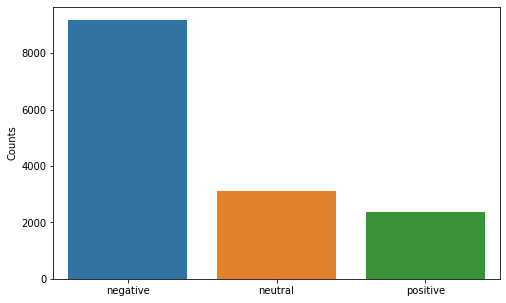

In [ ]:
counts = df.airline_sentiment.value_counts()

total_rows = len(df)
neg_percent = len(df[df.airline_sentiment == 'negative']) / total_rows
neu_percent = len(df[df.airline_sentiment == 'neutral']) / total_rows
pos_percent = len(df[df.airline_sentiment == 'positive']) / total_rows

print("negative tweet count: {:.2f}%\nneutral tweet count: {:.2f}%\npositive tweet count: {:.2f}%".format(
    neg_percent,
    neu_percent,
    pos_percent))
print()
print(counts, '\n')
plt.figure(figsize=(8,5))
sns.barplot(counts.index, counts)
plt.gca().set_ylabel('Counts')

### Tweets with a low sentiment confidence:

The tweet sentiments are probably labeled a ***human annotador***, for which there's a confidence value for each tweet sentiment.

A quick look at this column we notice that it has many tweets that have a sentiment confidence value very low(<0.4).

In [ ]:
confidence_threshold = 0.4

not_confident = df[df['airline_sentiment_confidence'] < confidence_threshold]
print("There are {} instances with a sentiment confidence lower than {},\n\
 they make up the {:.2f}% of all instances.".format(
    len(not_confident), confidence_threshold,
    len(not_confident) / len(df)
))
not_confident.head()

There are 236 instances with a sentiment confidence lower than 0.4,
 they make up the 0.02% of all instances.


,text,airline_sentiment_confidence,airline_sentiment
1,@VirginAmerica plus you've added commercials t...,0.3486,positive
114,@VirginAmerica come back to #PHL already. We n...,0.3482,positive
142,@VirginAmerica Can you find us a flt out of LA...,0.3550,neutral
183,😎 RT @VirginAmerica: You’ve met your match. Go...,0.3579,positive
309,@VirginAmerica is saving my sanity right now: ...,0.3750,neutral


In [ ]:
counts = df.airline_sentiment.value_counts()

pos_not_sure = len(not_confident[not_confident['airline_sentiment'] == 'positive'])
neg_not_sure = len(not_confident[not_confident['airline_sentiment'] == 'negative'])
neu_not_sure = len(not_confident[not_confident['airline_sentiment'] == 'neutral'])

print("positive tweets with a low sentiment confidence: {} --> {:.1f}%".format(pos_not_sure, pos_not_sure/counts[2]*100))
print("negative tweets with a low sentiment confidence: {} --> {:.1f}%".format(neg_not_sure, neg_not_sure/counts[0]*100))
print("neutral tweets with a low sentiment confidence: {} --> {:.1f}%".format(neu_not_sure, neu_not_sure/counts[1]*100))

positive tweets with a low sentiment confidence: 71 --> 3.0%
negative tweets with a low sentiment confidence: 63 --> 0.7%
neutral tweets with a low sentiment confidence: 102 --> 3.3%


As we can see here, the number of all low confidence tweets are not very high. We should consider the possibility of ***removing*** them from the dataset.

In [ ]:
text_label = not_confident['text'] + '  -->  ' + not_confident['airline_sentiment']
for t in text_label[10:20]:
    print(t)

@united thanks -- we filled it out. How's our luck with this? Is it common?  -->  positive
@united Your ERI-ORD express connections are hugely popular .. now if only we could have an ERI-EWR hop! :)  -->  negative
@united Done and done  -->  neutral
.Thnx for the response @united bot. It seems this 'improvement' could be easily attained. Is your 1st Class service really only worth $50?  -->  neutral
@united The bright side would be keeping the promise that was made to me. Hope you're having a good night. Thanks.  -->  negative
@united not just refunded, but for those of us who are on vacation to get a free room night to make up for making us sleep in DIA  -->  positive
@united He needs to get to home the 24th, they're telling him it'll be the 25th @ night. Is there compensation or anything that can be done?  -->  negative
@united Dmed you. Thank you  -->  negative
@united I left my comment with customer care. Thanks for contacting me.  -->  positive
Just sent thank u RT @united: @goode

### Text Analysis

In [ ]:
class EDA:
    def __init__(self, df):
        self.df = pd.read_csv(file_path)
        self.colors=['blue','red','green']
        self.categories = ['positive', 'negative', 'neutral']
        self.tweets_per_cat = [df[df['airline_sentiment'] == cat]['text'] for cat in self.categories]
        self.tokenizer = tokenizer

    def word_counts(self):
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10,5))
        
        content = [tweets.map(lambda t: len(self.tokenizer.tokenize(t))) for tweets in self.tweets_per_cat]

        for text, ax, color, cat in zip(content, (ax1, ax2, ax3), self.colors, self.categories):
            sns.distplot(text, ax=ax, color=color)
            ax.set_title(cat + ' Tweets')

        fig.suptitle('Word Count Distribution Per Sentiment Category')
        plt.show()
        plt.close()

    def most_freq_words(self, c=20, remove_at=True):
        print('Most Frequent Words Per Category\n')
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15,5))
        axis = (ax1, ax2, ax3)

        punc = string.punctuation
        table = str.maketrans(' ', ' ', punc)

        for i in range(3):
            if remove_at:
                all_words = self.tweets_per_cat[i].str.replace(r'@\w+|#\w+\b', '').str.lower().str.cat(sep=' ')
            else:
                all_words = self.tweets_per_cat[i].str.lower().str.cat(sep=' ')
            
            # word tokenization
            all_words = self.tokenizer.tokenize(all_words)
            # removing stop words and digitis
            all_words = [w for w in all_words if w not in stop and not w.isdigit()]
            # removing punctuation
            all_words = ' '.join(all_words).encode('ascii', 'ignore').decode('utf-8').translate(table)
            all_words = self.tokenizer.tokenize(all_words)
            
            freq = Counter(all_words).most_common(c)
            freq_df = pd.DataFrame(freq, columns=['word', 'count']).set_index('word')
            print(self.categories[i] + ' tweets')
            print(freq_df, '\n')
            freq_df.plot.bar(rot=65, ax=axis[i], color=self.colors[i])

        plt.show()
        plt.close()

    def analyse_at_hash(self):
        for pattern, p in zip([r'@\w+', r'#\w+\b'], ['@', '#']):
            words = re.findall(pattern, df['text'].str.lower().str.cat(sep=' '))
            count = Counter(words)
            print('Most Frequent ' + p + ':')
            print(*count.most_common(20), sep='\n')
            print("-- {} unique {}'s".format(len(count), p))
            print()
        
        def find_hash_at(tweet):
            return ', '.join(re.findall(r'@\w+|#\w+\b', tweet)) or None

        df['@/#'] = df['text'].map(lambda text: find_hash_at(text))
        # print('@/#')
        # print(df['@/#'])


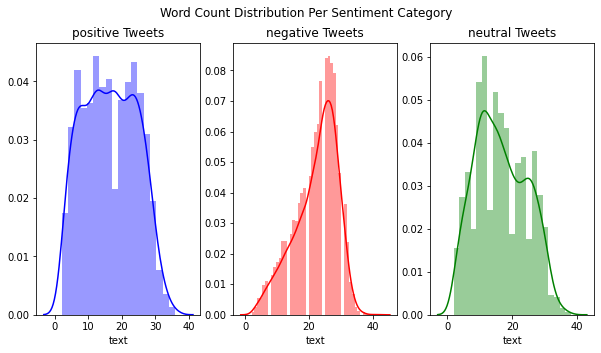

In [ ]:
eda = EDA(df)
eda.word_counts()

Most Frequent Words Per Category

positive tweets
          count
word           
thanks      607
thank       453
flight      375
great       236
service     161
love        131
customer    113
guys        111
good        108
best        104
got         100
awesome      98
time         95
im           83
help         83
today        82
airline      80
amazing      76
flying       69
crew         69 

negative tweets
           count
word            
flight      2919
cancelled    918
service      743
hours        651
hold         611
customer     607
help         600
time         588
im           531
plane        520
delayed      499
cant         483
flightled    446
hour         445
flights      423
bag          418
gate         410
late         375
need         374
phone        366 

neutral tweets
           count
word            
flight       604
need         164
flights      164
help         163
thanks       156
im           131
dm           122
tomorrow     106
fleek        106
kn

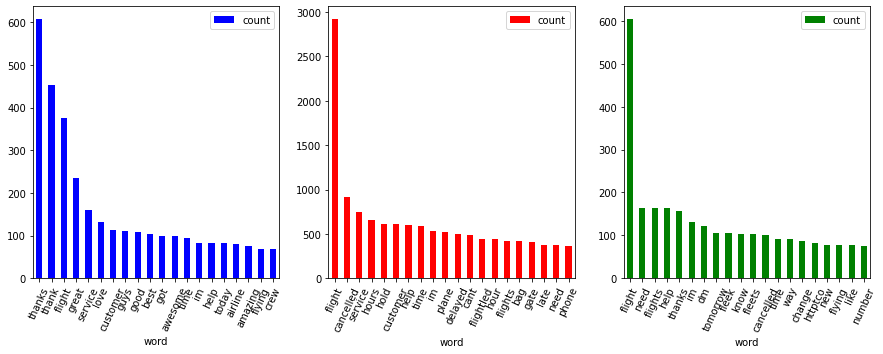

In [ ]:
eda.most_freq_words(remove_at=True)

In [ ]:
eda.analyse_at_hash()

Most Frequent @:
('@united', 3894)
('@usairways', 3000)
('@americanair', 2961)
('@southwestair', 2458)
('@jetblue', 2248)
('@virginamerica', 519)
('@delta', 68)
('@imaginedragons', 45)
('@phlairport', 20)
('@dfwairport', 17)
('@wsj', 13)
('@ladygaga', 12)
('@carrieunderwood', 12)
('@fortunemagazine', 12)
('@love_dragonss', 10)
('@virginatlantic', 9)
('@flytpa', 9)
('@cowboycerrone', 9)
('@staralliance', 8)
('@gg8929', 8)
-- 898 unique @'s

Most Frequent #:
('#destinationdragons', 81)
('#fail', 69)
('#jetblue', 48)
('#unitedairlines', 45)
('#customerservice', 36)
('#usairways', 30)
('#americanairlines', 27)
('#neveragain', 27)
('#united', 26)
('#usairwaysfail', 26)
('#disappointed', 25)
('#travel', 22)
('#avgeek', 22)
('#help', 21)
('#badservice', 21)
('#frustrated', 18)
('#badcustomerservice', 18)
('#nothappy', 14)
('#flight', 13)
('#epicfail', 12)
-- 2023 unique #'s



As we can see here, most of the **mentions**(@) are location or company related, which thier removal or replacement with '**constantmention**' won't affect the performamnce of our model in any noticeable way.

Same applies for **hashtags**(#). But we notice that, on top of mentioning locations and companies, many of them are about expressing disatisfactions such as **#epicfail**, **#frustrated**, **#badcustomerservice**, and **#fail**. 


Text(0, 0.5, 'Percentage of tweets with #')

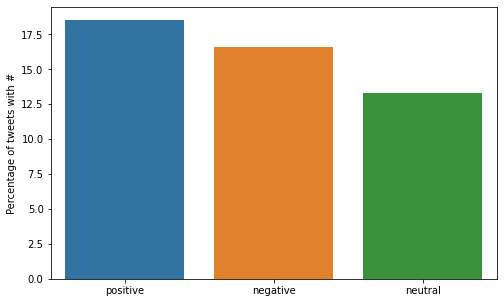

In [ ]:
def has_hashes(text):
    pattern = r'#\w+\b'
    hashes = re.findall(pattern, text)
    return True if hashes != [] else False

df['has_hashes'] = df['text'].map(lambda text: has_hashes(text))

df_with_hashes = df[df['has_hashes'] == True]
pos_with_hash = len(df_with_hashes[df_with_hashes['airline_sentiment'] == 'positive'])/counts[2] * 100
neg_with_hash = len(df_with_hashes[df_with_hashes['airline_sentiment'] == 'negative'])/counts[0] * 100
neu_with_hah = len(df_with_hashes[df_with_hashes['airline_sentiment'] == 'neutral'])/counts[1] * 100

plt.figure(figsize=(8, 5))
sns.barplot(['positive', 'negative', 'neutral'], [pos_with_hash, neg_with_hash, neu_with_hah])
plt.gca().set_ylabel('Percentage of tweets with #')

As shown above, the difference is very small and it should be considered a safe move to replace all hashtags with one token.

## Preprocessing For Social Media Text Data(SMTD):

The ***text data from social media*** are inherently ***noisy***, aside from having hashtags(#) and mentions(@), their generally also contain emojis, abbreviations, html tags, urls, and others. For this reason, it's indispensable a series of ***preprocessing steps*** to deal with this issue before ***feature engineering***.

In this section, we're going in create these preprocessing steps to remove the noises in our data.

In [14]:
!pip install demoji
import demoji
demoji.download_codes()

# !pip install textblob
# from textblob import TextBlob

# Credit to Anuj Gupta 
# https://github.com/practical-nlp/practical-nlp/blob/master/Ch8/O5_smtd_preprocessing.py

punc = string.punctuation #.replace('#', '').replace('@', '')
table = str.maketrans(' ', ' ', punc)

def to_lower(text):
    return text.lower()

def trim(text):
    return text.strp()

def remove_whiteSpaces(text):
    return re.sub(r'[\s]+', ' ', text)

def replace_amp(text):
    return text.replace('&amp', ' and ')

def replace_nums(text, remove=False):
    replace_to = ' ' if remove else ' constantnum '
    num_regex = r'(?<!#)\b(?:[+-]?[\d,]*[\.]?[\d,]*[\d]+|\d+)\b'
    return re.sub(num_regex, replace_to, text)

def replace_links(text, remove=False):
    replace_to = ' ' if remove else ' constanturl '
    return re.sub(r'(https?://\S+|www\.\S+)', replace_to, text)

def remove_html_tags(text):
    return re.sub(r'<.*?>', ' ', text)

def replace_mentions(text, remove=False):
    replace_to = ' ' if remove else ' constantmention '
    return re.sub(r'@(\w+)', replace_to, text)

def replace_hashtags(text, remove=False):
    replace_to = ' ' if remove else ' constanthashtag '
    return re.sub(r'#(\w+)\b', replace_to, text)

def replace_emojis(text):
    emojis = demoji.findall(text)
    if not emojis:
        return text

    tokenized_text = tokenizer.tokenize(text)
    for i, s in enumerate(tokenized_text):
        if s in emojis.keys():
            tokenized_text[i] = emojis[s]
    return ' '.join(tokenized_text)

def remove_emojis(text):
    return text.encode('ascii', 'ignore').decode('ascii')

def lemmatize_text(text):
    doc = nlp(text)
    lemms = []
    for token in doc:
        lem = token.lemma_ if token.lemma_ != '-PRON-' else token.text
        lemms.append(lem)
    return ' '.join(lemms)

def remove_stops(text):
    words = [w for w in tokenizer.tokenize(text) if w not in stop]
    return ' '.join(words)

def remove_punc(text):
    return text.translate(table)

def correct_spell(text):
    return str(TextBlob(text).correct())

def preprocess_tweet(text, remove=False, remove_stop=True):
    text = to_lower(text)
    text = replace_links(text, remove)
    text = remove_html_tags(text)
    text = replace_mentions(text, remove)
    text = replace_hashtags(text, remove)
    text = replace_nums(text, remove)
    text = replace_amp(text)
    text = replace_emojis(text)
    text = remove_emojis(text)
    text = lemmatize_text(text)
    if remove_stop:
        text = remove_stops(text)
    text = remove_punc(text)
    text = remove_whiteSpaces(text)
    # text = correct_spell(text)
    return text


... OK (Got response in 0.11 seconds)
Writing emoji data to /root/.demoji/codes.json ...
... OK


Applying the defined preprocessing steps. We're keeping two versions of preprocessed texts here, with and without ***stopwords***, and we can compare how the ml models will react the them.

After that, we proceed to remove the tweets with a very ***low sentiment confidence score***.

In [ ]:
%%time

df = pd.read_csv(file_path)
df['preprocessed_text'] = df['text'].map(lambda text: preprocess_tweet(text))
df['preprocessed_with_stop'] = df['text'].map(lambda text: preprocess_tweet(text, remove_stop=False))

CPU times: user 5min 32s, sys: 707 ms, total: 5min 33s
Wall time: 5min 33s


In [ ]:
df = df[['text', 'preprocessed_text', 'preprocessed_with_stop', 'airline_sentiment_confidence', 'airline_sentiment']]
df = df[df['airline_sentiment_confidence'] >= 0.4].reset_index(drop=True)
df.head()

,text,preprocessed_text,preprocessed_with_stop,airline_sentiment_confidence,airline_sentiment
0,@VirginAmerica What @dhepburn said.,constantmention constantmention say,constantmention what constantmention say,1.0000,neutral
1,@VirginAmerica I didn't today... Must mean I n...,constantmention today must mean need take anot...,constantmention i do not today must mean i ne...,0.6837,neutral
2,@VirginAmerica it's really aggressive to blast...,constantmention really aggressive blast obnoxi...,constantmention it be really aggressive to bl...,1.0000,negative
3,@VirginAmerica and it's a really big bad thing...,constantmention really big bad thing,constantmention and it be a really big bad th...,1.0000,negative
4,@VirginAmerica seriously would pay $30 a fligh...,constantmention seriously would pay constantnu...,constantmention seriously would pay constantn...,1.0000,negative


In [ ]:
file_name = 'preprocessed_file.pkl'
preprocessed_file_path = os.path.join(data_path, file_name)

df.to_pickle(preprocessed_file_path)

## Modelling:

We building a ML solution, we always start with a baseline model and then try to improve from there.

Some of the ideas to improve the model performance are:
1. Try different feature engineering.
2. Try different ML algorithms.
3. Try different preprocessing steps.

This modelling section is divided into the following subsections:

1 - Baseline models using Tfidf and the following models:
* Logistic Regression
* Naive Bayes

2 - Use word embeddings:
* Glove
* FastText

3 - Deep Learning Models:
* Sentence Encoding
* CNNs
* RNNs
* BERT

### Utils:

In [7]:
!pip install lime
from lime.lime_text import LimeTextExplainer

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

from joblib import dump, load
import itertools

In [ ]:
# Utils

def encode_sentiments(df):
    encoder = LabelEncoder()
    encoder.fit(df.airline_sentiment.unique())
    df['labels'] = encoder.transform(df.airline_sentiment)
    
    print('{} -> {}'.format(encoder.classes_, encoder.transform(encoder.classes_)))
    return encoder


def split_dataset(df, train_val_test=False):

    sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    for train_idx, test_val_idx in sss.split(df, df['labels']):
        train_set, test_val_set = df.loc[train_idx], df.loc[test_val_idx]
    
    if train_val_test:
        
        test_val_set.reset_index(drop=True, inplace=True)
        
        sss = StratifiedShuffleSplit(n_splits=1, test_size=0.5, random_state=42)
        for val_idx, test_idx in sss.split(test_val_set, test_val_set['labels']):
            val_set, test_set = test_val_set.loc[val_idx], test_val_set.loc[test_idx]

        # train_x, train_y = train_set['preprocessed_text'].values, train_set['labels'].values
        # val_x, val_y = val_set['preprocessed_text'].values, val_set['labels']
        # test_x, test_y = test_set['preprocessed_text'].values, test_set['labels'].values

        # print('Training set: {} instances\nValidation set: {} instances\nTest set: {} instances\n'.format(
        #     len(train_set), len(val_set), len(test_set)
        # ))

        for label in train_set['labels'].unique():
            print('{:.3f}% of class {} in train_set'.format(
                len(train_set[train_set['labels']==label]) / len(train_set) * 100,
                label))
            print('{:.3f}% of class {} in validation set'.format(
                len(val_set[val_set['labels']==label]) / len(val_set) * 100,
                label))
            print('{:.3f}% of class {} in test set'.format(
                len(test_set[test_set['labels']==label]) / len(test_set) * 100,
                label))
            print()

        return train_set, val_set, test_set
    
    else:
        # train_x, train_y = train_set['preprocessed_text'].values, train_set['labels'].values
        # test_x, test_y = test_val_set['preprocessed_text'].values, test_val_set['labels'].values

        print('Training instances: {}'.format(len(train_set)))
        print('Testing instances: {}'.format(len(test_val_set)))
        
        return train_set, _, test_val_set


def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label',fontsize=15)
    plt.xlabel('Predicted label',fontsize=15)

def get_sentiment(text, model, remove_stop=False):
    text = preprocess_tweet(text, remove_stop=remove_stop)
    pred = model.predict([text])
    print(text, '-->', encoder.inverse_transform(pred)[0])

def explain(text, model, show=True, remove_stop=False):
    text = preprocess_tweet(text, remove_stop=remove_stop)
    explainer = LimeTextExplainer(class_names=encoder.classes_)
    exp = explainer.explain_instance(text, model.predict_proba, num_features=6)
    if show:
        exp.show_in_notebook()
        fig = exp.as_pyplot_figure()
        return None
    else:
        return exp.as_list()

In [ ]:
!pip install nlpaug

import nlpaug.augmenter.word as naw
aug = naw.SynonymAug(aug_min=2, stopwords=['constanthashtag', 'constantmention', 'constanturl', 'constantnum'])

def tweet_augmentation(df, field, n=1):
    neg_counts, neu_counts, pos_counts = df.airline_sentiment.value_counts()

    positive_text = df[df['airline_sentiment'] == 'positive'][field]
    if n == 1:
        pos_text_added = [aug.augment(text, n=1) for text in positive_text]
    else:
        pos_text_added = [augmented for text in positive_text for augmented in aug.augment(text, n=n)]

    all_pos_text = list(df[df['airline_sentiment'] == 'positive'][field])
    all_pos_text.extend(pos_text_added)
    

    neutral_text = df[df['airline_sentiment'] == 'neutral'][field]
    if n == 1:
        neu_text_added = [aug.augment(text, n=1) for text in neutral_text]
    else:
        neu_text_added = [augmented for text in neutral_text for augmented in aug.augment(text, n=n)]
    all_neu_text = list(df[df['airline_sentiment'] == 'neutral'][field])
    all_neu_text.extend(neu_text_added)
    
    print('Added {} new positive tweets using synonim augmentation.'.format(len(pos_text_added)))
    print('Added {} new neutral tweets using synonim augmentation.'.format(len(neu_text_added)), '\n')

    print('Tweet counts after text augmentation:')
    print('negative', neg_counts)
    print('positive: {} --> {}'.format(pos_counts, len(all_pos_text)))
    print('neutral: {} --> {}'.format(neu_counts, len(all_neu_text)), '\n')

    all_neg_text = df[df['airline_sentiment'] == 'negative'][field]
    all_texts = list(all_neg_text) + all_pos_text + all_neu_text
    all_labels = [0] * neg_counts + [2] * len(all_pos_text) + [1] * len(all_neu_text)
    
    augmented_df = pd.DataFrame(data={field: all_texts, 'labels': all_labels})
    augmented_df = augmented_df.sample(frac=1).reset_index(drop=True)
    
    return augmented_df


In [8]:
# loading preprocessed dataframe
file_name = 'preprocessed_file.pkl'
preprocessed_file_path = os.path.join(data_path, file_name)

df = pd.read_pickle(preprocessed_file_path)
# df.head()

# encode labels and split the dataset into training and testing sets
train_set_path = os.path.join(data_path, 'train_set.pkl')
test_set_path = os.path.join(data_path, 'test_set.pkl')

encoder = encode_sentiments(df)

train_set, _, test_set = split_dataset(df)
train_set.to_pickle(train_set_path)
test_set.to_pickle(test_set_path)
# train_set = pd.read_pickle(train_set_path)
# test_set = pd.read_pickle(test_set_path)

X = train_set['preprocessed_text'].values
X_with_stop = train_set['preprocessed_with_stop'].values

Y = train_set['labels'].values

x_test = test_set['preprocessed_text'].values
x_test_with_stop = test_set['preprocessed_with_stop'].values

y_test = test_set['labels'].values

# define directory for all models to save
model_folder = os.path.join(path, 'models')

['negative' 'neutral' 'positive'] -> [0 1 2]
Training instances: 11523
Testing instances: 2881


### Baseline Models:

#### Logistic Regression:



##### 1 - Training with text data without augmentation, with stop words removed:

In [ ]:
# Experimenting with Logistic Regression without text data augmentation
# and replacing the tags, mentions, and other elements with 'constant...'

lr_pipe = Pipeline([
                    ('vect', TfidfVectorizer()),
                    ('lr', LogisticRegression(max_iter=7600, random_state=42))
        ])

param_grid = {
    'vect__tokenizer': [None, tokenizer.tokenize],
    'vect__ngram_range': [(1, 1), (1, 2)],
    'vect__max_features': [None, 5000],
    'vect__binary': [False, True],
    'lr__class_weight': [None, 'balanced'],
}

lr_gs = GridSearchCV(estimator=lr_pipe,
                     param_grid=param_grid,
                     return_train_score=True)


%time lr_gs.fit(X, Y)

lr_clf_NoStop = lr_gs.best_estimator_
print(lr_clf_NoStop)

CPU times: user 8min 30s, sys: 4min 16s, total: 12min 46s
Wall time: 7min 36s
Pipeline(memory=None,
         steps=[('vect',
                 TfidfVectorizer(analyzer='word', binary=False,
                                 decode_error='strict',
                                 dtype=<class 'numpy.float64'>,
                                 encoding='utf-8', input='content',
                                 lowercase=True, max_df=1.0, max_features=5000,
                                 min_df=1, ngram_range=(1, 1), norm='l2',
                                 preprocessor=None, smooth_idf=True,
                                 stop_words=None, strip_accents=None,
                                 sublinear_tf=False,
                                 token_pattern='(...
                                 tokenizer=<bound method TweetTokenizer.tokenize of <nltk.tokenize.casual.TweetTokenizer object at 0x7fead0ab6208>>,
                                 use_idf=True, vocabulary=None)),
         

In [ ]:
# saving the model

lr_clf_NoStop_path = os.path.join(model_folder, 'lr_clf_NoStop.joblib')
dump(lr_clf_NoStop, lr_clf_NoStop_path)

['/content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/lr_clf_NoRemoval.joblib']

In [ ]:
lr_clf_NoStop_preds = lr_clf_NoStop.predict(x_test)
print(classification_report(y_test, lr_clf_NoStop_preds))
print(accuracy_score(y_test, lr_clf_NoStop_preds))

              precision    recall  f1-score   support

           0       0.80      0.92      0.86      1823
           1       0.64      0.46      0.53       600
           2       0.82      0.65      0.72       458

    accuracy                           0.78      2881
   macro avg       0.76      0.68      0.71      2881
weighted avg       0.77      0.78      0.77      2881

0.7820201318986463


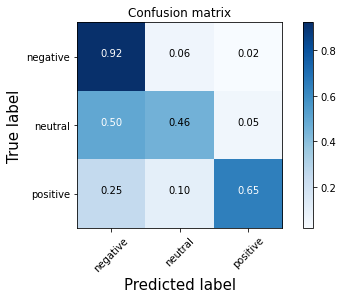

In [ ]:
cm_NoStop = confusion_matrix(y_test, lr_clf_NoStop_preds)
plot_confusion_matrix(cm_NoStop, encoder.classes_, True)

flight cancel call customer service --> negative


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


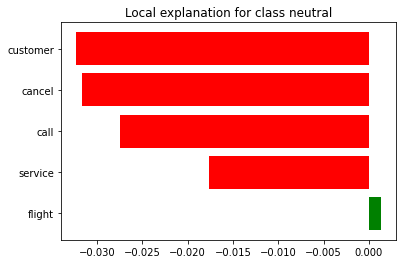

In [ ]:
lr_clf_NoStop_path = os.path.join(model_folder, 'lr_clf_NoStop.joblib')
lr_clf_NoStop = load(lr_clf_NoStop_path)

text = "the flight was cancelled, I'll call customer service"
get_sentiment(text, lr_clf_NoStop, remove_stop=True)
explain(text, lr_clf_NoStop, remove_stop=True)

##### 2 - Training with text data without augmentation, keeping stopwords:


In [ ]:
# Check how many unique words are there

all_words = df['preprocessed_with_stop'].str.cat(sep=' ')
all_tokens = tokenizer.tokenize(all_words)
len(set(all_tokens))

9017

In [ ]:
lr_pipe = Pipeline([
                    ('vect', TfidfVectorizer()),
                    ('lr', LogisticRegression(max_iter=7600, random_state=42))
        ])

param_grid = {
    'vect__tokenizer': [None, tokenizer.tokenize],
    'vect__ngram_range': [(1, 1), (1, 2), (2, 2)],
    'vect__max_features': [None, 5000, 7000],
    'vect__binary': [False, True],
    'lr__class_weight': [None, 'balanced'],
}

lr_gs = GridSearchCV(estimator=lr_pipe,
                     param_grid=param_grid,
                     return_train_score=True)


In [ ]:
%time lr_gs.fit(X_with_stop, Y)

lr_clf_WithRemoval = lr_gs.best_estimator_
print(lr_clf_WithRemoval)

CPU times: user 20min 52s, sys: 9min 19s, total: 30min 12s
Wall time: 18min 45s
Pipeline(memory=None,
         steps=[('vect',
                 TfidfVectorizer(analyzer='word', binary=True,
                                 decode_error='strict',
                                 dtype=<class 'numpy.float64'>,
                                 encoding='utf-8', input='content',
                                 lowercase=True, max_df=1.0, max_features=None,
                                 min_df=1, ngram_range=(1, 2), norm='l2',
                                 preprocessor=None, smooth_idf=True,
                                 stop_words=None, strip_accents=None,
                                 sublinear_tf=False,
                                 token_pattern='(?...
                                 tokenizer=<bound method TweetTokenizer.tokenize of <nltk.tokenize.casual.TweetTokenizer object at 0x7fe29e112d68>>,
                                 use_idf=True, vocabulary=None)),
       

In [ ]:
lr_clf_WithStop_path = os.path.join(model_folder, 'lr_clf_WithStop.joblib')
dump(lr_clf_WithStop, lr_clf_WithStop_path)

['/content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/lr_clf_WithStop.joblib']

In [ ]:
lr_clf_WithStop_preds = lr_clf_WithStop.predict(x_test_with_stop)
print(classification_report(y_test, lr_clf_WithStop_preds))
print(accuracy_score(y_test, lr_clf_WithStop_preds))

              precision    recall  f1-score   support

           0       0.89      0.86      0.87      1823
           1       0.65      0.68      0.66       600
           2       0.75      0.78      0.76       458

    accuracy                           0.81      2881
   macro avg       0.76      0.77      0.77      2881
weighted avg       0.81      0.81      0.81      2881

0.810829573064908


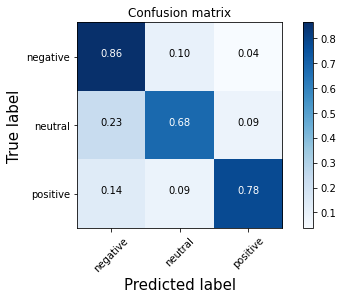

In [ ]:
cm_WithStop = confusion_matrix(y_test, lr_clf_WithStop_preds)
plot_confusion_matrix(cm_WithStop, encoder.classes_, True)

the flight be cancel i will call customer service --> negative


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


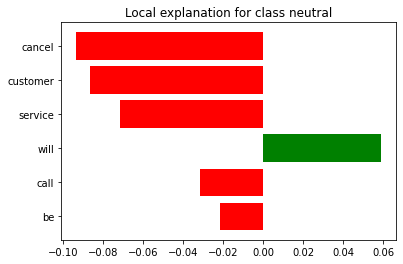

In [ ]:
# lr_clf_WithStop_path = os.path.join(model_folder, 'lr_clf_WithStop.joblib')
# lr_clf_WithStop = load(lr_clf_WithStop_path)

text = "the flight was cancelled, I'll call customer service"
get_sentiment(text, lr_clf_WithStop)
explain(text, lr_clf_WithRemoval)

Seems like it's much better to ***keep the stopwords***. Despite the minor drop on predicting negative tweets, both neutral and positive tweets the accuracy are improved significantly.

Notice that during grid search, the model has decided that it'd prefere ***keeping all the words***(max_features=None), instead of counting the term frequency it uses ***binary***, and class_weights are ***balanced***.

Now let's try increasing the number of positive and neutral tweets, and see if it helps.

##### 3 - Training with text data with augmentation(keeping stopwords):

In [ ]:
# apply text data augmentation
file_aug = 'augmented_file.pkl'
aug_path = os.path.join(data_path, file_aug)

field = 'preprocessed_with_stop'
augmented_train_set = tweet_augmentation(train_set, field, n=2)
augmented_train_set.to_pickle(aug_path)
# augmented_train_set = pd.read_pickle(aug_path)

X_aug, Y_aug = augmented_train_set[field].values, augmented_train_set['labels'].values

augmented_train_set.head()

Added 3544 new positive tweets using synonim augmentation.
Added 4728 new neutral tweets using synonim augmentation. 

Tweet counts after text augmentation:
negative 7292
positive: 1834 --> 5378
neutral: 2397 --> 7125 



,preprocessed_with_stop,labels
0,constantmention can you please dm me my fligh...,0
1,constantmention can you share where informatio...,1
2,constantmention horrible service wrong plane ...,0
3,constantmention thank so much my passport be r...,2
4,constantmention close down,0


In [ ]:
# Find out how many unique words are there in our training set.
# This information helps finding the range of vocabulary size to test.

unique_words = set(tokenizer.tokenize(augmented_train_set[field].str.cat(sep=' ')))
len(unique_words)

10674

In [ ]:
lr_pipe = Pipeline([
                    ('vect', TfidfVectorizer()),
                    ('lr', LogisticRegression(max_iter=7600, random_state=42))
        ])

param_grid = {
    'vect__tokenizer': [None, tokenizer.tokenize],
    'vect__ngram_range': [(1, 1), (1, 2), (2, 2)],
    'vect__max_features': [None, 7000, 9000],
    'vect__binary': [False, True]
}

lr_gs_aug = GridSearchCV(estimator=lr_pipe,
                         param_grid=param_grid,
                         return_train_score=True)


%time lr_gs_aug.fit(X_aug, Y_aug)

lr_clf_aug = lr_gs_aug.best_estimator_
print(lr_clf_aug)

CPU times: user 19min 2s, sys: 8min 52s, total: 27min 54s
Wall time: 17min 5s
Pipeline(memory=None,
         steps=[('vect',
                 TfidfVectorizer(analyzer='word', binary=True,
                                 decode_error='strict',
                                 dtype=<class 'numpy.float64'>,
                                 encoding='utf-8', input='content',
                                 lowercase=True, max_df=1.0, max_features=None,
                                 min_df=1, ngram_range=(1, 2), norm='l2',
                                 preprocessor=None, smooth_idf=True,
                                 stop_words=None, strip_accents=None,
                                 sublinear_tf=False,
                                 token_pattern='(?...
                                 tokenizer=<bound method TweetTokenizer.tokenize of <nltk.tokenize.casual.TweetTokenizer object at 0x7fe232b0ff60>>,
                                 use_idf=True, vocabulary=None)),
         

In [ ]:
lr_clf_aug_path = os.path.join(model_folder, 'lr_clf_aug.joblib')
dump(lr_clf_aug, lr_clf_aug_path)

In [ ]:
lr_clf_aug_preds = lr_clf_aug.predict(x_test_with_stop)
print(classification_report(y_test, lr_clf_aug_preds))
print(accuracy_score(y_test, lr_clf_aug_preds))

              precision    recall  f1-score   support

           0       0.86      0.91      0.88      1823
           1       0.69      0.63      0.66       600
           2       0.80      0.73      0.76       458

    accuracy                           0.82      2881
   macro avg       0.78      0.76      0.77      2881
weighted avg       0.82      0.82      0.82      2881

0.8212426240888581


Model with Data Augmentation


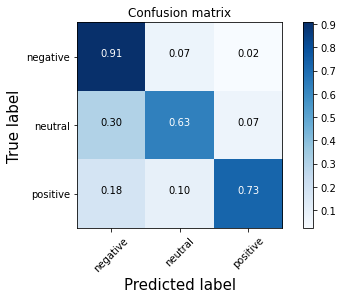

In [ ]:
print('Model with Data Augmentation')
cm_aug = confusion_matrix(y_test, lr_clf_aug_preds)
plot_confusion_matrix(cm_aug, encoder.classes_, True)

Model without Data Augmentation


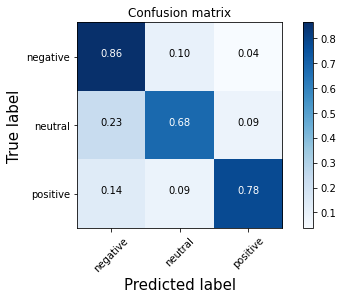

In [ ]:
print('Model without Data Augmentation')
plot_confusion_matrix(cm_WithStop, encoder.classes_, True)

The accuracy increased by more than **1%** and it's mainly due to that increase in performance on **negative** tweets.

For both **neutral** and **positive** tweets, performance has **dropped** despite having more training instances.

**This method of increasing text data may not outperform undersampling.**

the flight be cancel i will call customer service --> negative


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


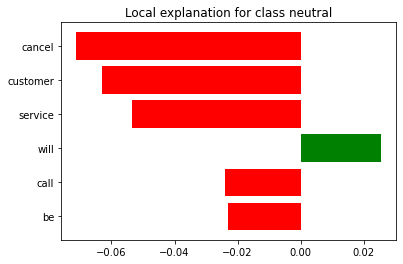

In [ ]:
# lr_clf_aug_path = os.path.join(model_folder, 'lr_clf_aug.joblib')
# lr_clf_aug = load(lr_clf_aug_path)

text = "the flight was cancelled, I'll call customer service"
get_sentiment(text, lr_clf_aug)
explain(text, lr_clf_aug)

###### Error Analysis:

In [9]:
lr_clf_aug_path = os.path.join(model_folder, 'lr_clf_aug.joblib')
lr_clf_aug = load(lr_clf_aug_path)

predicted_proba = lr_clf_aug.predict_proba(x_test_with_stop)
predicted_class = lr_clf_aug.predict(x_test_with_stop)

sentiment_dict = {0: 'negative', 1:'neutral', 2:'positive'}
sentiment = [sentiment_dict[label] for label in y_test]

to_analyze = pd.DataFrame(data={'text': x_test_with_stop,
                                'true_class': y_test,
                                'predicted_class': predicted_class,
                                'sentiment': sentiment,
                                '0_proba': predicted_proba[:, 0],
                                '1_proba': predicted_proba[:, 1],
                                '2_proba': predicted_proba[:, 2]})

to_analyze.head(10)

,text,true_class,predicted_class,sentiment,0_proba,1_proba,2_proba
0,constantmention finally get ahold of an agent...,0,2,negative,0.274051,0.064420,0.661529
1,constantmention hello my baggage have be lose...,0,0,negative,0.871796,0.093385,0.034820
2,constantmention screw me up big 1st flight 1h...,0,0,negative,0.954774,0.029984,0.015242
3,constantmention you all should really be asha...,0,0,negative,0.555129,0.067663,0.377208
4,constantmention even after run to gate from y...,0,0,negative,0.955105,0.012781,0.032113
5,constantmention have getaway deal through may...,1,2,neutral,0.122101,0.272848,0.605050
6,constantmention what be the status of flight ...,1,1,neutral,0.078410,0.898739,0.022852
7,constantmention when be you put some great de...,2,1,positive,0.106642,0.539887,0.353471
8,constantmention i do dm the detail but still ...,0,0,negative,0.820387,0.144290,0.035323
9,constantmention how about auto check in for c...,0,1,negative,0.428211,0.524180,0.047609


In [10]:
def get_frequent_words(df, correct=True):
    if correct:
        filter = df['true_class'] == df['predicted_class']
        title = 'Most Frequent Words - Correct Predictions(top 20%)'
        asc = False
    else:
        filter = df['true_class'] != df['predicted_class']
        title = 'Most Frequent Words - Wrong Predictions(bottom 20%)'
        asc = True

    print(title)
    cats = df.true_class.unique()
    df = df[filter]
    to_remove = set(['constantmention', 'constanthashtag', 'constantnum', 'constanturl'])

    for cat in cats:
        print('Category: %s' % sentiment_dict[cat])
        category_tweets = df[df['true_class'] == cat]
        top_ = int(len(category_tweets) * 0.2)
        print(top_)
        col = str(cat) + '_proba'
        category_tweets.sort_values(col, ascending=asc).reset_index()
        category_tweets = category_tweets[:top_]

        text = category_tweets['text'].str.cat(sep=' ')
        all_words = tokenizer.tokenize(text)
        all_words = [word for word in all_words if word not in to_remove]
        counts = Counter(all_words).most_common(10)
        data = pd.DataFrame(counts, columns=['word', 'counts']).set_index('word')
        print(data, '\n')


def get_word_counts(df, correct=True):
    print('Tweet Word Counts')
    if correct:
        filter = df['true_class'] == df['predicted_class']
        title = 'Word Length Dist - Correct Predictions'
        asc = False
    else:
        filter = df['true_class'] != df['predicted_class']
        title = 'Word Length Dist - Wrong Predictions'
        asc = True

    cats = df.true_class.unique()
    df = df[filter]
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 5))

    for cat, ax in zip(cats, (ax1, ax2, ax3)):
        print('Category: %s' % sentiment_dict[cat])
        category_tweets = df[df['true_class'] == cat]
        top_ = int(len(category_tweets) * 0.3)
        print(top_)
        col = str(cat) + '_proba'
        category_tweets.sort_values(col, ascending=asc).reset_index()
        category_tweets = category_tweets[:top_]

        counts = category_tweets['text'].map(lambda text: len(tokenizer.tokenize(text)))
        sns.distplot(counts, ax=ax)
        ax.set_title(sentiment_dict[cat] + ' Tweets')

    fig.suptitle(title)
    plt.show()
    plt.close()


def explain_predictions(df, cat, correct=True, model=lr_clf_aug):
    if correct:
        filter = df['true_class'] == df['predicted_class']
        title = 'Best Correct Predictions'
        asc = False
    else:
        filter = df['true_class'] != df['predicted_class']
        title = 'Worst Wrong Predictions'
        asc = True

    print(title)
    df = df[filter]

    # for cat in cats:
    print('Category: %s' % sentiment_dict[cat])
    category_tweets = df[df['true_class'] == cat]
    col = str(cat) + '_proba'
    category_tweets.sort_values(col, ascending=asc, inplace=True)
    category_tweets.reset_index()
    category_tweets = category_tweets['text'][:3]
    for text in category_tweets:
        explain(text, model, show=True)
    print()

Worst Wrong Predictions
Category: negative


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]







Worst Wrong Predictions
Category: neutral


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]







Worst Wrong Predictions
Category: positive


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


/usr/local/lib/python3.6/dist-packages/lime/lime_text.py:114: FutureWarning: split() requires a non-empty pattern match.
  self.as_list = [s for s in splitter.split(self.raw) if s]


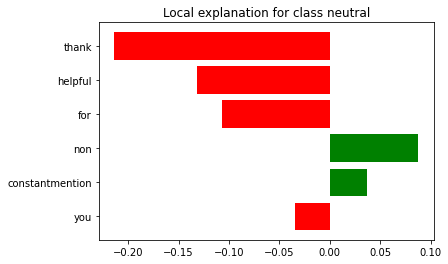

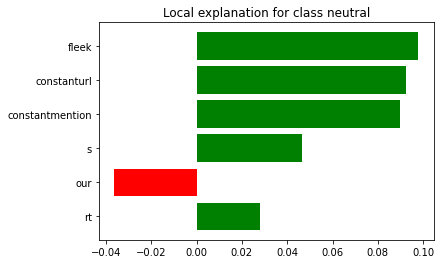

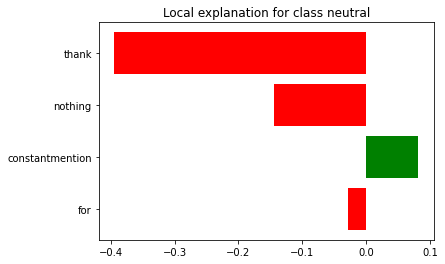

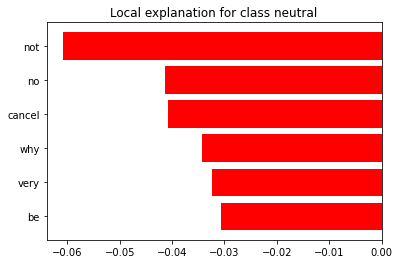

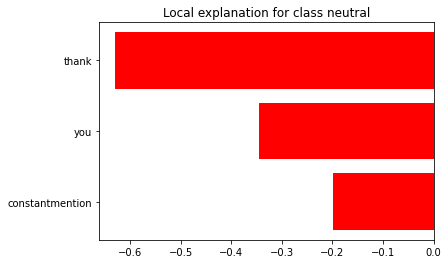

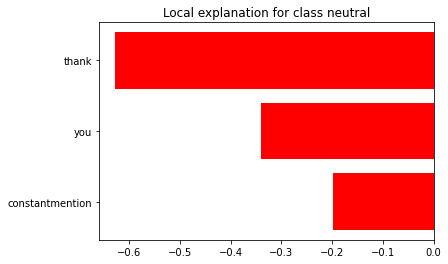

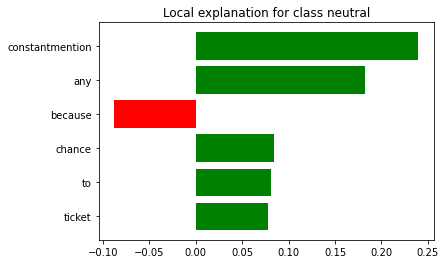

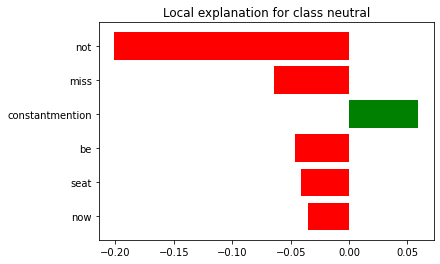

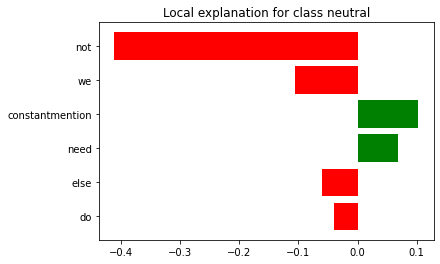

In [15]:
explain_predictions(to_analyze, 0, False)
print('\n\n\n')
explain_predictions(to_analyze, 1, False)
print('\n\n\n')
explain_predictions(to_analyze, 2, False)

#### Naive Bayes:

In [ ]:
nb_pipe = Pipeline([
                 ('vect', TfidfVectorizer(tokenizer=tokenizer.tokenize)),
                 ('lr', MultinomialNB())
        ])

param_grid = {
    'vect__ngram_range': [(1, 1), (1, 2), (2, 2)],
    'vect__max_features': [None, 5000],
    'vect__binary': [False, True]
}

nb_grid_search = GridSearchCV(estimator=nb_pipe,
                              param_grid=param_grid,
                              return_train_score=True)

In [ ]:
%time nb_grid_search.fit(X_with_stop, Y)

CPU times: user 2min 22s, sys: 249 ms, total: 2min 23s
Wall time: 2min 23s


GridSearchCV(cv=None, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('vect',
                                        TfidfVectorizer(analyzer='word',
                                                        binary=False,
                                                        decode_error='strict',
                                                        dtype=<class 'numpy.float64'>,
                                                        encoding='utf-8',
                                                        input='content',
                                                        lowercase=True,
                                                        max_df=1.0,
                                                        max_features=None,
                                                        min_df=1,
                                                        ngram_range=(1, 1),
                                                       

In [ ]:
nb_clf_aug = nb_grid_search.best_estimator_
print(nb_clf_aug)

nb_clf_aug_path = os.path.join(model_folder, 'nb_clf_aug.joblib')
dump(nb_clf_aug, nb_clf_aug_path)

Pipeline(memory=None,
         steps=[('vect',
                 TfidfVectorizer(analyzer='word', binary=True,
                                 decode_error='strict',
                                 dtype=<class 'numpy.float64'>,
                                 encoding='utf-8', input='content',
                                 lowercase=True, max_df=1.0, max_features=5000,
                                 min_df=1, ngram_range=(1, 2), norm='l2',
                                 preprocessor=None, smooth_idf=True,
                                 stop_words=None, strip_accents=None,
                                 sublinear_tf=False,
                                 token_pattern='(?u)\\b\\w\\w+\\b',
                                 tokenizer=<bound method TweetTokenizer.tokenize of <nltk.tokenize.casual.TweetTokenizer object at 0x7fe2322f37f0>>,
                                 use_idf=True, vocabulary=None)),
                ('lr',
                 MultinomialNB(alpha=1.0, class_pr

['/content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/nb_clf_aug.joblib']

In [ ]:
nb_clf_aug_path = os.path.join(model_folder, 'nb_clf_aug.joblib')
nb_clf_aug = load(nb_clf_aug_path)

nb_preds = nb_clf_aug.predict(x_test)
print(classification_report(y_test, nb_preds))
print(accuracy_score(y_test, nb_preds))

              precision    recall  f1-score   support

           0       0.76      0.96      0.85      1823
           1       0.68      0.31      0.43       600
           2       0.83      0.53      0.65       458

    accuracy                           0.76      2881
   macro avg       0.76      0.60      0.64      2881
weighted avg       0.75      0.76      0.73      2881

0.7563346060395696


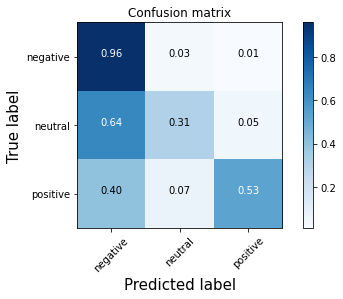

In [ ]:
nb_cm = confusion_matrix(y_test, nb_preds)
plot_confusion_matrix(nb_cm, encoder.classes_, True)

Not any better than our LR model!!!

### Embeddings:

#### Gensim embeddings:

##### Glove:

So far we've been using a distributional text representations(tf-idf) on eighter unigram or bigrams.

This way of representing text is practical and robust, but the problem is that the obtained vectors are too sparse. Say that we have about 7000 words in out vocabulary, using tf-idf, a sentence with only 10 words will still have 7000 components with the majority of them being 0's.

Now let's try word embeddings, a distributed representation for words. Each embedding vector can have a predefined length and all components are made of floating point values. To represent a sentence, we will average then embeddings of all words in it.

In [ ]:
import gensim.downloader as api
from gensim.models import Word2Vec, KeyedVectors

In [ ]:
# Let's take a look at all the available models in Gensim
info = api.info()

for model_name, model_data in sorted(info['models'].items()):
    print(
        '%s (%d records): %s' % (
            model_name,
            model_data.get('num_records', -1),
            model_data['description'][:40] + '...',
        )
    )

__testing_word2vec-matrix-synopsis (-1 records): [THIS IS ONLY FOR TESTING] Word vecrors ...
conceptnet-numberbatch-17-06-300 (1917247 records): ConceptNet Numberbatch consists of state...
fasttext-wiki-news-subwords-300 (999999 records): 1 million word vectors trained on Wikipe...
glove-twitter-100 (1193514 records): Pre-trained vectors based on  2B tweets,...
glove-twitter-200 (1193514 records): Pre-trained vectors based on 2B tweets, ...
glove-twitter-25 (1193514 records): Pre-trained vectors based on 2B tweets, ...
glove-twitter-50 (1193514 records): Pre-trained vectors based on 2B tweets, ...
glove-wiki-gigaword-100 (400000 records): Pre-trained vectors based on Wikipedia 2...
glove-wiki-gigaword-200 (400000 records): Pre-trained vectors based on Wikipedia 2...
glove-wiki-gigaword-300 (400000 records): Pre-trained vectors based on Wikipedia 2...
glove-wiki-gigaword-50 (400000 records): Pre-trained vectors based on Wikipedia 2...
word2vec-google-news-300 (3000000 records): Pre-trai

In [ ]:
# loading the embedding matrix
%time glove_twitter = api.load('glove-twitter-200')

[================================================--] 97.3% 738.4/758.5MB downloadedCPU times: user 6min 4s, sys: 20 s, total: 6min 24s
Wall time: 7min


In [ ]:
def vocab_overlap(train_x, model):
    """Get vocabulary overlap between out corpus
    and the embedding matrix"""

    all_words = pd.Series(train_x).str.cat(sep=' ')
    all_tokens = tokenizer.tokenize(all_words)
    unique_tokens = set(all_tokens)
    word_counts = len(unique_tokens)

    count = 0
    for token in unique_tokens:
        if token in model:
            count += 1
    overlap = count / word_counts * 100
    print('Vocabulary overlap: {:.3f}%'.format(overlap))

def embedding_feats(sentences, model, dims=200):
    """ Get embeddings for sentences.
    Simply averaging out the embedding of their constituent words.
    """

    tokenized_sents = [tokenizer.tokenize(sent) for sent in sentences]
    features = []
    for sent in tokenized_sents:
        curr_features = np.zeros(dims)
        curr_count = 0
        for token in sent:
            if token in model:
                curr_features += model[token]
                curr_count += 1
        if curr_count == 0:
            curr_count = 1
        features.append(curr_features/curr_count)
    return np.stack(features)

In [ ]:
# Calculate vocabulary overlap.
# If the overlap is below 80%, we may be better off training out own embeddings.

vocab_overlap(X_with_stop, glove_twitter)

Vocabulary overlap: 82.508%


In [ ]:
train_feats = embedding_feats(X_with_stop, glove_twitter)
test_feats = embedding_feats(x_test_with_stop, glove_twitter)

print("Training instances shape:", train_feats.shape)

Training instances shape: (11523, 200)


In [ ]:
%%time

lr_with_embedding = LogisticRegression(max_iter=7600, random_state=42, )

lr_with_embedding.fit(train_feats, Y)
print(lr_with_embedding)

lr_with_embedding_path = os.path.join(model_folder, 'lr_with_embedding.joblib')
dump(lr_with_embedding, lr_with_embedding_path)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=7600,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=42, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


['/content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/lr_with_embedding.joblib']

In [ ]:
lr_with_embedding_preds = lr_with_embedding.predict(test_feats)
print(classification_report(y_test, lr_with_embedding_preds))
print(accuracy_score(y_test, lr_with_embedding_preds))

              precision    recall  f1-score   support

           0       0.82      0.93      0.87      1823
           1       0.65      0.49      0.56       600
           2       0.81      0.63      0.71       458

    accuracy                           0.79      2881
   macro avg       0.76      0.68      0.71      2881
weighted avg       0.78      0.79      0.78      2881

0.790003471017008


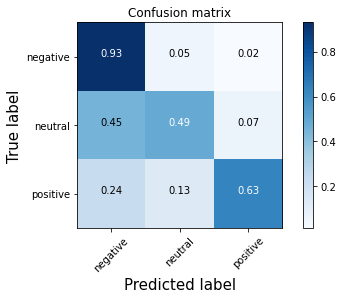

In [ ]:
lr_with_embedding_preds_cm = confusion_matrix(y_test, lr_with_embedding_preds)
plot_confusion_matrix(lr_with_embedding_preds_cm, encoder.classes_, True)

Using glove embeddings trained on tweets doesn't seem to improve the performance. In comparison to the same model using tf-idf, its performance has dropped.

In [ ]:
del glove_twitter

##### Training out own embeddings:


In [ ]:
%%time

corpus = [tokenizer.tokenize(sentence) for sentence in X_with_stop]
model_w2v = Word2Vec(corpus, size=100, min_count=3)

CPU times: user 3.28 s, sys: 32.3 ms, total: 3.31 s
Wall time: 2.38 s


In [ ]:
dataset_embedding_path = os.path.join(model_folder, 'w2v_embedding.bin')
model_w2v.save(dataset_embedding_path)

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:254: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


In [ ]:
words = model_w2v.wv.vocab
print("Number of words in our embedding matrix: {}".format(len(words)))

Number of words in our embedding matrix: 3016


This reduced number of words in the embedding matrix is basically telling us that it wouldn't word well!

In [ ]:
train_feats = embedding_feats(X_with_stop, model_w2v, dims=100)
test_feats = embedding_feats(x_test_with_stop, model_w2v, dims=100)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:28: DeprecationWarning: Call to deprecated `__contains__` (Method will be removed in 4.0.0, use self.wv.__contains__() instead).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


In [ ]:
lr_dataset_emb = LogisticRegression(max_iter=7600, random_state=42, )

lr_dataset_emb.fit(train_feats, Y)
print(lr_dataset_emb)

lr_dataset_emb_path = os.path.join(model_folder, 'lr_dataset_emb.joblib')
# dump(lr_dataset_emb, lr_dataset_emb_path)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=7600,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=42, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


In [ ]:
lr_dataset_emb_preds = lr_dataset_emb.predict(test_feats)
print(classification_report(y_test, lr_dataset_emb_preds))
print(accuracy_score(y_test, lr_dataset_emb_preds))

              precision    recall  f1-score   support

           0       0.72      0.95      0.82      1823
           1       0.57      0.24      0.34       600
           2       0.72      0.36      0.48       458

    accuracy                           0.71      2881
   macro avg       0.67      0.52      0.55      2881
weighted avg       0.69      0.71      0.67      2881

0.7101700798333912


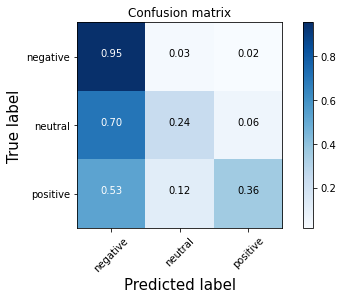

In [ ]:
lr_dataset_emb_preds_cm = confusion_matrix(y_test, lr_dataset_emb_preds)
plot_confusion_matrix(lr_dataset_emb_preds_cm, encoder.classes_, True)

In [ ]:
del model_w2v

#### FastText

FastText is a type of embeddings that instead of words, its trained using subwords. It usually works well on SMTD given its noisy nature.

In [ ]:
!pip install fasttext
from fasttext import train_supervised

     |████████████████████████████████| 71kB 1.5MB/s 
  Created wheel for fasttext: filename=fasttext-0.9.2-cp36-cp36m-linux_x86_64.whl size=3019938 sha256=b820a9a8f485cb0bdca6912a7afcd1da383e235a507ce66dc087a693aca5a99b
  Stored in directory: /root/.cache/pip/wheels/98/ba/7f/b154944a1cf5a8cee91c154b75231136cc3a3321ab0e30f592
Successfully built fasttext


In [ ]:
dict_ = {0: 'negative', 1:'neutral', 2:'positive'}

train_path = os.path.join(data_path, 'fasttext_train.csv')
train_df = pd.DataFrame(data={'text': X_with_stop, 'label': Y})
# train_df['text'] = train_df['text'].map(lambda text: text.encode('ascii', 'ignore').decode('utf-8'))
train_df['label'] = train_df['label'].map(lambda label: '__label__' + dict_[label])
train_df.to_csv(train_path, header=None, index=False, columns=['text', 'label'], sep=' ')

test_path = os.path.join(data_path, 'fasttext_test.csv')
test_df = pd.DataFrame(data={'text': x_test_with_stop, 'label': y_test})
# test_df['text'] = test_df['text'].map(lambda text: text.encode('ascii', 'ignore').decode('utf-8'))
test_df['label'] = test_df['label'].map(lambda label: '__label__' + dict_[label])
test_df.to_csv(test_path, header=None, index=False, columns=['text', 'label'], sep=' ')

In [ ]:
train_df.head()

,text,label
0,constantmention your customer service be a di...,__label__negative
1,constantmention please stop ask me each week ...,__label__negative
2,constantmention s constanthashtag email be on...,__label__positive
3,constantmention a companion pass flyer to oth...,__label__negative
4,constantmention no problem thing work out at ...,__label__positive


In [ ]:
%%time

fast_model = train_supervised(input=train_path, lr=0.01, epoch=100,
                              wordNgrams=2, dim=200)

CPU times: user 27.9 s, sys: 998 ms, total: 28.9 s
Wall time: 29 s


In [ ]:
fast_model.test(test_path)

(2881, 0.8167303019784797, 0.8167303019784797)

In [ ]:
text = "too bad that the flight was cancelled, i'll call customer service"
text = preprocess_tweet(text)
print(text)
fast_model.predict(text)[0][0][9:]

bad flight cancel call customer service


'negative'

In [ ]:
from collections import OrderedDict


texts = test_df['text']
labels = test_df['label']

total_correct_count = 0
classification_rp = OrderedDict(
    {'__label__negative': OrderedDict({'tp': 0, '__label__neutral': 0, '__label__positive': 0}),
     '__label__neutral': OrderedDict({'__label__negative': 0, 'tp': 0, '__label__positive': 0}),
     '__label__positive': OrderedDict({'__label__negative': 0, '__label__neutral': 0, 'tp': 0})})

for text, label in zip(texts, labels):
    prediction = fast_model.predict(text)[0][0]
    if prediction == label:
        total_correct_count += 1
        classification_rp[prediction]['tp'] += 1
    else:
        classification_rp[label][prediction] += 1

print(total_correct_count / len(test_df))

0.8153418951752863


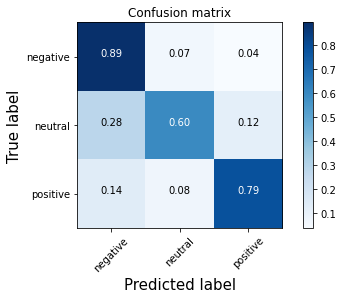

In [ ]:
fast_cm = np.array([list(val.values()) for val in classification_rp.values()])
plot_confusion_matrix(fast_cm, encoder.classes_, True)

We see a minor improvement on accuracy in comparison to the best LR model.
The only drawback is that there's a increased number of neutral tweets are being missclassified as negative ones.

### Deep Learning Models:

#### Sentence Encoding with nnlm:

In [19]:
%tensorflow_version 2.x

import tensorflow as tf
import tensorflow_hub as hub
from tensorflow import keras

from collections import OrderedDict


embedding_layer = hub.KerasLayer("https://tfhub.dev/google/nnlm-en-dim128/2",
                                 input_shape=[], dtype=tf.string)

In [21]:
def get_nnmodel(embedding_layer):
    nnmodel = keras.models.Sequential([
                                    embedding_layer,
                                    keras.layers.Dense(128, activation='relu', name='dense_1'),
                                    keras.layers.Dense(64, activation='relu', name='dense_2'),
                                    keras.layers.Dense(3, activation='softmax', name='output')
    ])

    nnmodel.compile(optimizer=keras.optimizers.Adam(lr=1e-4),
                    loss='sparse_categorical_crossentropy', metrics=['acc'])
    return nnmodel

def get_report(keras_model, data):
    predictions = keras_model.predict(data)
    predicted_class = [np.argmax(prediction) for prediction in predictions]

    correct_count = 0
    report = OrderedDict(
        {0: OrderedDict({'tp': 0, 1: 0, 2: 0}),
        1: OrderedDict({0: 0, 'tp': 0, 2: 0}),
        2: OrderedDict({0: 0, 1: 0, 'tp': 0})})

    for true_class, predict_class in zip(y_test, predicted_class):
        if predict_class == true_class:
            correct_count += 1
            report[predict_class]['tp'] += 1
        else:
            report[true_class][predict_class] += 1

    print(correct_count / y_test.shape[0], '\n')

    keras_model_cm = np.array([list(val.values()) for val in report.values()])
    plot_confusion_matrix(keras_model_cm, encoder.classes_, True)

# put more emphasis on neutral and positive tweets when calculating losses.
class_weights = {
    0: 1,
    1: 1.5,
    2: 2
}

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_acc',
                                                  verbose=1,
                                                  patience=10,
                                                  mode='max',
                                                  restore_best_weights=True)

In [61]:
nnmodel = get_nnmodel(embedding_layer)
nnmodel.fit(X_with_stop, Y, batch_size=64,
            epochs=50, class_weight=class_weights,
            validation_split=0.05, callbacks=[early_stopping])

Epoch 1/50
172/172 [==============================] - 1s 6ms/step - loss: 1.2731 - acc: 0.6264 - val_loss: 0.8293 - val_acc: 0.6603
Epoch 2/50
172/172 [==============================] - 1s 5ms/step - loss: 1.1161 - acc: 0.7019 - val_loss: 0.7333 - val_acc: 0.7487
Epoch 3/50
172/172 [==============================] - 1s 6ms/step - loss: 0.9777 - acc: 0.7343 - val_loss: 0.6558 - val_acc: 0.7764
Epoch 4/50
172/172 [==============================] - 1s 5ms/step - loss: 0.8880 - acc: 0.7553 - val_loss: 0.6230 - val_acc: 0.7886
Epoch 5/50
172/172 [==============================] - 1s 6ms/step - loss: 0.8396 - acc: 0.7627 - val_loss: 0.5806 - val_acc: 0.7955
Epoch 6/50
172/172 [==============================] - 1s 5ms/step - loss: 0.8122 - acc: 0.7685 - val_loss: 0.5754 - val_acc: 0.7868
Epoch 7/50
172/172 [==============================] - 1s 5ms/step - loss: 0.7957 - acc: 0.7730 - val_loss: 0.5832 - val_acc: 0.7972
Epoch 8/50
172/172 [==============================] - 1s 4ms/step - loss: 0.

0.7514751822283929 



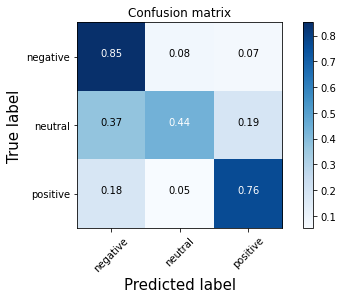

In [63]:
get_report(nnmodel, x_test_with_stop)

In [62]:
nnmodel_1 = get_nnmodel()
nnmodel_1.fit(X_with_stop, Y, batch_size=64,
              epochs=50, validation_split=0.05,
              callbacks=[early_stopping])

Epoch 1/50
172/172 [==============================] - 1s 6ms/step - loss: 0.9136 - acc: 0.6123 - val_loss: 0.7988 - val_acc: 0.6464
Epoch 2/50
172/172 [==============================] - 1s 5ms/step - loss: 0.7751 - acc: 0.6612 - val_loss: 0.7067 - val_acc: 0.7054
Epoch 3/50
172/172 [==============================] - 1s 5ms/step - loss: 0.6847 - acc: 0.7238 - val_loss: 0.6395 - val_acc: 0.7747
Epoch 4/50
172/172 [==============================] - 1s 5ms/step - loss: 0.6246 - acc: 0.7528 - val_loss: 0.5913 - val_acc: 0.7799
Epoch 5/50
172/172 [==============================] - 1s 5ms/step - loss: 0.5913 - acc: 0.7648 - val_loss: 0.5664 - val_acc: 0.7920
Epoch 6/50
172/172 [==============================] - 1s 4ms/step - loss: 0.5706 - acc: 0.7742 - val_loss: 0.5533 - val_acc: 0.7903
Epoch 7/50
172/172 [==============================] - 1s 4ms/step - loss: 0.5603 - acc: 0.7751 - val_loss: 0.5494 - val_acc: 0.7920
Epoch 8/50
172/172 [==============================] - 1s 4ms/step - loss: 0.

0.7695244706699063 



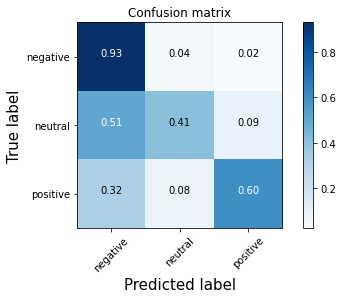

In [64]:
get_report(nnmodel_1)

LR using tf-idf and keeping the stopwords is still our best approach!!!

#### CNN with Glove:

In [25]:
%tensorflow_version 2.x

import tensorflow as tf
import tensorflow_hub as hub
from tensorflow import keras
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

In [26]:
MAX_NUM_WORDS = 10000
OOV_BUCKET = 100
MAX_SEQUENCE_LENGTH = 70
EMBEDDING_DIM = 200

keras_tokenizer = Tokenizer(num_words=MAX_NUM_WORDS, oov_token=OOV_BUCKET)
keras_tokenizer.fit_on_texts(X_with_stop)

In [27]:
train_sequences = keras_tokenizer.texts_to_sequences(X_with_stop)
test_sequences = keras_tokenizer.texts_to_sequences(x_test_with_stop)

train_data = pad_sequences(train_sequences, maxlen=MAX_SEQUENCE_LENGTH)
test_data = pad_sequences(test_sequences, maxlen=MAX_SEQUENCE_LENGTH)

In [ ]:
import gensim.downloader as api
from gensim.models import Word2Vec, KeyedVectors

%time glove_twitter = api.load('glove-twitter-200')

[==================================================] 100.0% 758.5/758.5MB downloaded


/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:254: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


CPU times: user 6min 17s, sys: 24 s, total: 6min 41s
Wall time: 7min 27s


In [ ]:
word_index = keras_tokenizer.word_index

word_count = 0
for word in word_index.keys():
    if word in glove_twitter:
        word_count += 1
print('Vocab overlap:', word_count / len(word_index) * 100)

Vocab overlap: 82.45548961424333


In [ ]:
num_words = max(MAX_NUM_WORDS, len(word_index)) + 1
embedding_matrix = np.zeros((num_words, EMBEDDING_DIM))
for word, index in word_index.items():
    if word in glove_twitter:
        embedding_matrix[index] = glove_twitter[word]

embedding_layer = keras.layers.Embedding(num_words, EMBEDDING_DIM,
                                         embeddings_initializer=keras.initializers.Constant(embedding_matrix),
                                         input_length=MAX_SEQUENCE_LENGTH,
                                         trainable=False)

In [ ]:
cnn_model = keras.models.Sequential([
                                    embedding_layer,
                                    keras.layers.Conv1D(200, 5, activation='relu',
                                                        padding='SAME', name='conv1d_1'),
                                    keras.layers.MaxPooling1D(5, padding='SAME', name='max_pool_1'),
                                    keras.layers.Conv1D(200, 5, activation='relu',
                                                        padding='SAME', name='conv1d_2'),
                                    keras.layers.MaxPooling1D(5, padding='SAME', name='max_pool_2'),
                                    keras.layers.Conv1D(200, 5, activation='relu',
                                                        padding='SAME', name='conv1d_3'),
                                    # keras.layers.GlobalMaxPooling1D(name='global_max_pool'),
                                    keras.layers.Flatten(),
                                    keras.layers.Dropout(0.5),
                                    keras.layers.Dense(128, activation='relu', name='dense_1'),
                                    keras.layers.Dense(3, activation='softmax', name='output')
])

cnn_model.compile(optimizer='adam', metrics=['acc'],
                  loss='sparse_categorical_crossentropy')

BATCH_SIZE = 64
EPOCHS = 10

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_acc',
                                                  verbose=1,
                                                  patience=5,
                                                  mode='max',
                                                  restore_best_weights=True)

cnn_model.fit(
    train_data, Y,
    batch_size=BATCH_SIZE, epochs=EPOCHS, 
    validation_split=0.15,
    callbacks=[early_stopping]
    )

Epoch 1/10
154/154 [==============================] - 2s 16ms/step - loss: 0.6568 - acc: 0.7291 - val_loss: 0.5329 - val_acc: 0.7750
Epoch 2/10
154/154 [==============================] - 2s 13ms/step - loss: 0.4313 - acc: 0.8359 - val_loss: 0.6026 - val_acc: 0.7721
Epoch 3/10
154/154 [==============================] - 2s 13ms/step - loss: 0.2878 - acc: 0.8903 - val_loss: 0.5932 - val_acc: 0.8068
Epoch 4/10
154/154 [==============================] - 2s 13ms/step - loss: 0.1687 - acc: 0.9430 - val_loss: 0.5762 - val_acc: 0.8172
Epoch 5/10
154/154 [==============================] - 2s 13ms/step - loss: 0.1109 - acc: 0.9658 - val_loss: 0.6703 - val_acc: 0.8010
Epoch 6/10
154/154 [==============================] - 2s 14ms/step - loss: 0.0884 - acc: 0.9699 - val_loss: 0.8222 - val_acc: 0.7906
Epoch 7/10
154/154 [==============================] - 2s 13ms/step - loss: 0.0591 - acc: 0.9810 - val_loss: 0.9840 - val_acc: 0.8086
Epoch 8/10
154/154 [==============================] - 2s 14ms/step - 

In [ ]:
cnn_model.evaluate(test_data, y_test, return_dict=True)

91/91 [==============================] - 1s 6ms/step - loss: 0.6350 - acc: 0.8039


{'acc': 0.8038875460624695, 'loss': 0.6349654793739319}

In [ ]:
cnn_path = os.path.join(model_folder, 'cnn_model')
cnn_model.save(cnn_path)

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/cnn_model/assets


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/cnn_model/assets


0.8038875390489414 



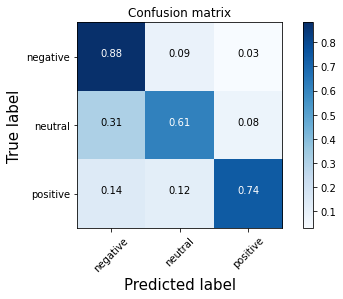

In [28]:
# cnn_path = os.path.join(model_folder, 'cnn_model')
# cnn_model = keras.models.load_model(cnn_path)
get_report(cnn_model, test_data)

#### LSTM with Glove:

In [ ]:
lstm_model = keras.models.Sequential([
                                    embedding_layer,
                                    keras.layers.LSTM(200, dropout=0.2, recurrent_dropout=0.2),
                                    keras.layers.Dense(3, activation='softmax')
])

lstm_model.compile(optimizer='adam', metrics=['acc'],
                  loss='sparse_categorical_crossentropy')

BATCH_SIZE = 64
EPOCHS = 10

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_acc',
                                                  verbose=1,
                                                  patience=5,
                                                  mode='max',
                                                  restore_best_weights=True)

lstm_model.fit(
    train_data, Y,
    batch_size=BATCH_SIZE, epochs=EPOCHS, 
    validation_split=0.15,
    callbacks=[early_stopping]
    )

Epoch 1/10
154/154 [==============================] - 59s 383ms/step - loss: 0.6497 - acc: 0.7361 - val_loss: 0.5293 - val_acc: 0.7820
Epoch 2/10
154/154 [==============================] - 58s 373ms/step - loss: 0.5277 - acc: 0.7870 - val_loss: 0.4888 - val_acc: 0.8039
Epoch 3/10
154/154 [==============================] - 56s 364ms/step - loss: 0.4896 - acc: 0.8077 - val_loss: 0.4806 - val_acc: 0.8080
Epoch 4/10
154/154 [==============================] - 56s 366ms/step - loss: 0.4675 - acc: 0.8169 - val_loss: 0.4616 - val_acc: 0.8207
Epoch 5/10
154/154 [==============================] - 58s 375ms/step - loss: 0.4328 - acc: 0.8306 - val_loss: 0.4711 - val_acc: 0.8195
Epoch 6/10
154/154 [==============================] - 58s 375ms/step - loss: 0.4193 - acc: 0.8335 - val_loss: 0.4638 - val_acc: 0.8213
Epoch 7/10
154/154 [==============================] - 58s 374ms/step - loss: 0.3824 - acc: 0.8500 - val_loss: 0.4704 - val_acc: 0.8184
Epoch 8/10
154/154 [==============================] - 5

In [ ]:
lstm_model.evaluate(test_data, y_test, return_dict=True)

91/91 [==============================] - 4s 38ms/step - loss: 0.5591 - acc: 0.8133


{'acc': 0.8132593035697937, 'loss': 0.5591077208518982}

In [ ]:
lstm_path = os.path.join(model_folder, 'lstm_model')
lstm_model.save(lstm_path)

INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/lstm_model/assets


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/Twitter US Airline Sentiment/models/lstm_model/assets


In [29]:
lstm_path = os.path.join(model_folder, 'lstm_model')
lstm_model = keras.models.load_model(lstm_path)

0.8132592849704964 



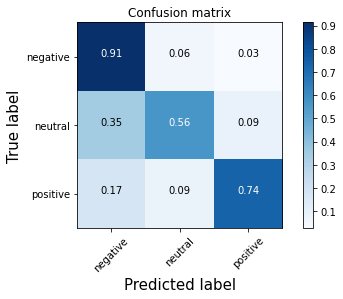

In [30]:
get_report(lstm_model, test_data)

#### BERT

In [6]:
!pip install bert-for-tf2
!pip install sentencepiece

%tensorflow_version 2.x
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow import keras

import bert
FullTokenizer = bert.bert_tokenization.FullTokenizer

     |████████████████████████████████| 40kB 2.9MB/s 
  Created wheel for bert-for-tf2: filename=bert_for_tf2-0.14.6-cp36-none-any.whl size=30318 sha256=d46bfe6d979e24eac971fb21ef1eeed1070ce95c5045f876f6fe546cccc2a5e8
  Stored in directory: /root/.cache/pip/wheels/07/a0/b4/75b0601ebaa41e517a797fe9cea119c789664c8408f8a74ae9
  Created wheel for py-params: filename=py_params-0.9.7-cp36-none-any.whl size=7304 sha256=66b6be11a8cfa732e0089fa7dab1dc58dd46183ddf1b81489d169a7c7ff4a4d7
  Stored in directory: /root/.cache/pip/wheels/67/f5/19/b461849a50aefdf4bab47c4756596e82ee2118b8278e5a1980
  Created wheel for params-flow: filename=params_flow-0.8.2-cp36-none-any.whl size=19475 sha256=4e8b3eef668fedd89c0e6aecb601e980325043e16baf7741a0385e0b02ea39db
  Stored in directory: /root/.cache/pip/wheels/08/c8/7f/81c86b9ff2b86e2c477e3914175be03e679e596067dc630c06
Successfully built bert-for-tf2 py-params params-flow
     |████████████████████████████████| 1.1MB 6.6MB/s 


In [7]:
MAX_SEQ_LENGTH = 160
MODEL_URL = "https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/1"

bert_layer = hub.KerasLayer(MODEL_URL, trainable=True)

vocab_file = bert_layer.resolved_object.vocab_file.asset_path.numpy()
do_lower_case = bert_layer.resolved_object.do_lower_case.numpy()
bert_tokenizer = FullTokenizer(vocab_file, do_lower_case)

words_to_remove = set(['constantmention', 'constanthashtag', 'constanturl', 'constantnum'])

def filter_constants(data):
    filtered_data = []
    for text in data:
        words = [word for word in text.split() if word not in words_to_remove]
        filtered_data.append(' '.join(words))
    return filtered_data

def encode_for_bert(X):
    all_ids = []
    all_masks= []
    all_segments = []

    for text in X:
        tokens = bert_tokenizer.tokenize(text)
        tokens = ['[CLS]'] + tokens + ['[SEP]']

        padding_length = MAX_SEQ_LENGTH - len(tokens)
        
        token_ids = bert_tokenizer.convert_tokens_to_ids(tokens)
        token_ids += [0] * padding_length
        
        token_masks = [1] * len(tokens) + [0] * padding_length
        token_segments = [0] * MAX_SEQ_LENGTH

        all_ids.append(token_ids)
        all_masks.append(token_masks)
        all_segments.append(token_segments)
    
    return np.array(all_ids), np.array(all_masks), np.array(all_segments)


def get_model(bert_layer=bert_layer):
    input_word_ids = keras.layers.Input(shape=(MAX_SEQ_LENGTH,),
                                        dtype=tf.int32,
                                        name="input_ids")
    
    input_mask = keras.layers.Input(shape=(MAX_SEQ_LENGTH,),
                                    dtype=tf.int32,
                                    name="input_mask")
    
    segment_ids = keras.layers.Input(shape=(MAX_SEQ_LENGTH,),
                                        dtype=tf.int32,
                                        name="segment_ids")

    _, sequence_output = bert_layer([input_word_ids, input_mask, segment_ids])
    clf_output = sequence_output[:, 0, :]
    out = keras.layers.Dense(3, activation='softmax')(clf_output)
    
    model = keras.models.Model(inputs=[input_word_ids, input_mask, segment_ids], outputs=out)
    # model.summary()

    opt = keras.optimizers.Adam(lr=1e-4)
    model.compile(optimizer=opt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [ ]:
X_train_with_stop = filter_constants(X_with_stop)
X_test_with_stop = filter_constants(x_test_with_stop)

print('Before filtering:', X_with_stop[0])
print('After filtering:', X_train_with_stop[0])

X_train_bert = encode_for_bert(X_train_with_stop)
x_test_bert = encode_for_bert(X_test_with_stop)

Before filtering:  constantmention your customer service be a disgrace 
After filtering: your customer service be a disgrace


In [ ]:
BATCH_SIZE = 32
EPOCHS = 5

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  verbose=1,
                                                  patience=3,
                                                  mode='max',
                                                  restore_best_weights=True)

bert = get_model()
training_hist = bert.fit(X_train_bert, Y,
                         batch_size=BATCH_SIZE, epochs=EPOCHS,
                         validation_split=0.1, callbacks=[early_stopping])


Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_ids (InputLayer)          [(None, 160)]        0                                            
__________________________________________________________________________________________________
input_mask (InputLayer)         [(None, 160)]        0                                            
__________________________________________________________________________________________________
segment_ids (InputLayer)        [(None, 160)]        0                                            
__________________________________________________________________________________________________
keras_layer (KerasLayer)        [(None, 768), (None, 109482241   input_ids[0][0]                  
                                                                 input_mask[0][0]      

In [ ]:
bert_path = os.path.join(model_folder, 'bert_')
bert.save(bert_path)

In [ ]:
# bert_path = os.path.join(model_folder, 'bert_')
# bert = tf.keras.models.load_model(model_path)

keras.backend.clear_session()
bert.evaluate(x_test_bert, y_test)

91/91 [==============================] - 19s 204ms/step - loss: 0.6808 - accuracy: 0.8216


[0.6807603240013123, 0.8215897083282471]

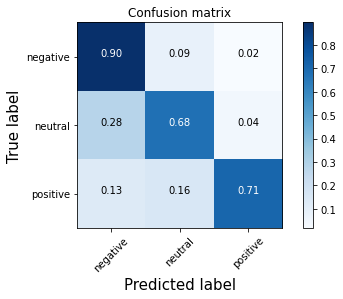

In [ ]:
from collections import OrderedDict

bert_predictions = bert.predict(x_test_bert)
bert_predicted_class = [np.argmax(prediction) for prediction in bert_predictions]

correct_count = 0
classification_rp_bert = OrderedDict(
    {0: OrderedDict({'tp': 0, 1: 0, 2: 0}),
     1: OrderedDict({0: 0, 'tp': 0, 2: 0}),
     2: OrderedDict({0: 0, 1: 0, 'tp': 0})})

for true_class, predict_class in zip(y_test, bert_predicted_class):
    if predict_class == true_class:
        correct_count += 1
        classification_rp_bert[predict_class]['tp'] += 1
    else:
        classification_rp_bert[true_class][predict_class] += 1

print(correct_count / y_test.shape[0])

bert_cm = np.array([list(val.values()) for val in classification_rp_bert.values()])
plot_confusion_matrix(bert_cm, encoder.classes_, True)

BERT came close to the best version of LR for this task!

However, if we were to deploy one model trained above, LR + tfidf + stopwords 
will be the chosen one. It's much faster to run and take much less memory!